In [59]:
__author__ = "Nurdinov Rostislav"
__date__   = "2022-06-10"

# Initializing

In [60]:
from typing import List, Dict, Any, Union

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from pathlib import Path

from PIL import Image
import cv2
import imagesize

import warnings

In [61]:
# Settings
warnings.filterwarnings("ignore")

# Pandas
pd.options.display.max_rows = 50
pd.options.display.max_colwidth = 70

In [62]:
# Path
ROOT = Path.cwd()
PATH_TO_IMAGES = ROOT / ".." / "data" / "raw" / "images"
PATH_TO_XLSX = ROOT / ".." / "data" / "raw" / "data.xlsx"

# General information about DataFrame

In [63]:
df = pd.read_excel(PATH_TO_XLSX)

In [64]:
display(df.head(10))
print(f"DataFrame shape: {df.shape}")

,file_name,container
0,18_4514603367515_1694923-e76724a8-d8b6-4803-9fd8-f02168dd3190.jpg,bottle
1,779_4514603367515_1190777-47bc675b-8f1b-4ad4-8728-497abaa65a56.jpg,bottle
2,1027_4514603367515_91629.png,bottle
3,1103_4514603367515_1125434-cf538b18-c542-4e39-9f9c-93026e85293e.jpg,bottle
4,515_4514603378313_51825.png,bottle
5,58_4514603345414_65845964.jpg,bottle
6,512_4514603244915_22453.png,bottle
7,675_4514603347210_90749.png,bottle
8,57_4514603351514_29714072.jpg,bottle
9,150_4514603367218_6869285.jpg,bottle


DataFrame shape: (1975, 2)


In [65]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1975 entries, 0 to 1974
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   file_name  1975 non-null   object
 1   container  1975 non-null   object
dtypes: object(2)
memory usage: 31.0+ KB


# Distribution of the number of containers

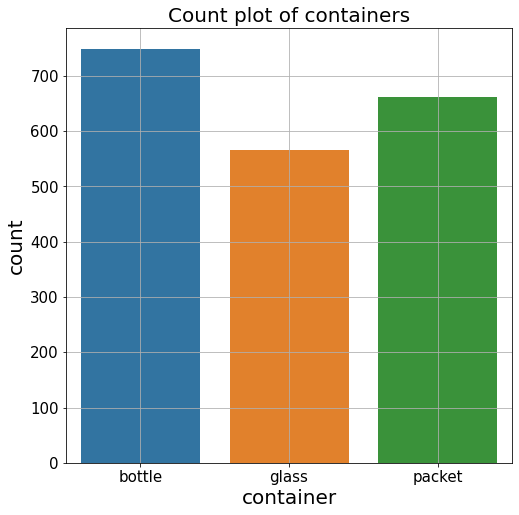

In [66]:
plt.figure(figsize=(8, 8))
sns.countplot(x="container", data=df)
plt.title("Count plot of containers", fontsize=20)
plt.xlabel("container", fontsize=20)
plt.ylabel("count", fontsize=20)
plt.yticks(size=15)
plt.xticks(size=15)
plt.grid()
plt.show()

# Visualizing

## Helper functions

In [67]:
def open_image(path: Union[Path, str]) -> Image.Image:
    """Function for open a image by the path
    
    Args:
        path (Union[Path, str]): image path
    
    Returns:
        image (Image.Image): return the image
    """
    return Image.open(path)


def display_df(
    df: pd.DataFrame,
    subtitle: str = "",
    nrows: int = 5,
    ncols: int = 4,
    num: int = 20,
    img_size: int = 224,
    figsize: tuple = (20, 30)) -> None:
    """Function for open a image by the path
    
    Args:
        path (Union[Path, str]): image path
    
    Returns:
        image (Image.Image): return the image
    """

    plt.figure(figsize=figsize)
    for idx, row in df.iterrows():
        plt.subplot(nrows, ncols, idx+1)
        img = open_image(row.img_path)
        img = img.resize((img_size, img_size))
        plt.imshow(img)
        plt.axis('off')
        title = row.file_name[-min(len(row.file_name), 18):]
        plt.title(title, size=18)
    if subtitle:
        plt.suptitle(subtitle, size=30)
    plt.tight_layout()
    plt.show()
    

def get_image_size(path: Union[str, Path]) -> (int, int, int):
    """Get width, height and dimension of image by path
    
    Args:
        path: (Union[str, Path]): image path
    
    Returns:
        width (int): width of image
        height (int): height of image
        dimension (int): dimension of image
    """
    width, height = imagesize.get(path)
    return width, height, width * height

## Add full path and image size to DataFrame

In [68]:
# Full path
df["img_path"] = df.apply(lambda row: str(PATH_TO_IMAGES / row.file_name), axis=1)

# Image size values
df["width"], df["height"], df["dimension"] = zip(*df.apply(lambda row: get_image_size(row.img_path), axis=1))

In [69]:
df.head()

,file_name,container,img_path,width,height,dimension
0,18_4514603367515_1694923-e76724a8-d8b6-4803-9fd8-f02168dd3190.jpg,bottle,/home/nurdinov/Desktop/quatra_rad/notebooks/../data/raw/images/18_...,540,720,388800
1,779_4514603367515_1190777-47bc675b-8f1b-4ad4-8728-497abaa65a56.jpg,bottle,/home/nurdinov/Desktop/quatra_rad/notebooks/../data/raw/images/779...,474,800,379200
2,1027_4514603367515_91629.png,bottle,/home/nurdinov/Desktop/quatra_rad/notebooks/../data/raw/images/102...,369,500,184500
3,1103_4514603367515_1125434-cf538b18-c542-4e39-9f9c-93026e85293e.jpg,bottle,/home/nurdinov/Desktop/quatra_rad/notebooks/../data/raw/images/110...,563,800,450400
4,515_4514603378313_51825.png,bottle,/home/nurdinov/Desktop/quatra_rad/notebooks/../data/raw/images/515...,352,500,176000


## Image height and width distribution

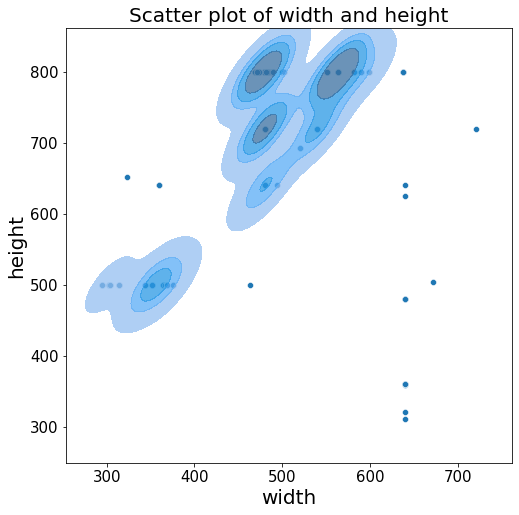

In [70]:
plt.figure(figsize=(8, 8))
sns.scatterplot(data=df, x="width", y="height")
sns.kdeplot(data=df, x="width", y="height", levels=5, fill=True, alpha=0.75, cut=2)
plt.title("Scatter plot of width and height", fontsize=20)
plt.xlabel("width", fontsize=20)
plt.ylabel("height", fontsize=20)
plt.yticks(size=15)
plt.xticks(size=15)

plt.show()

## Filtering and visualizing data by categorization

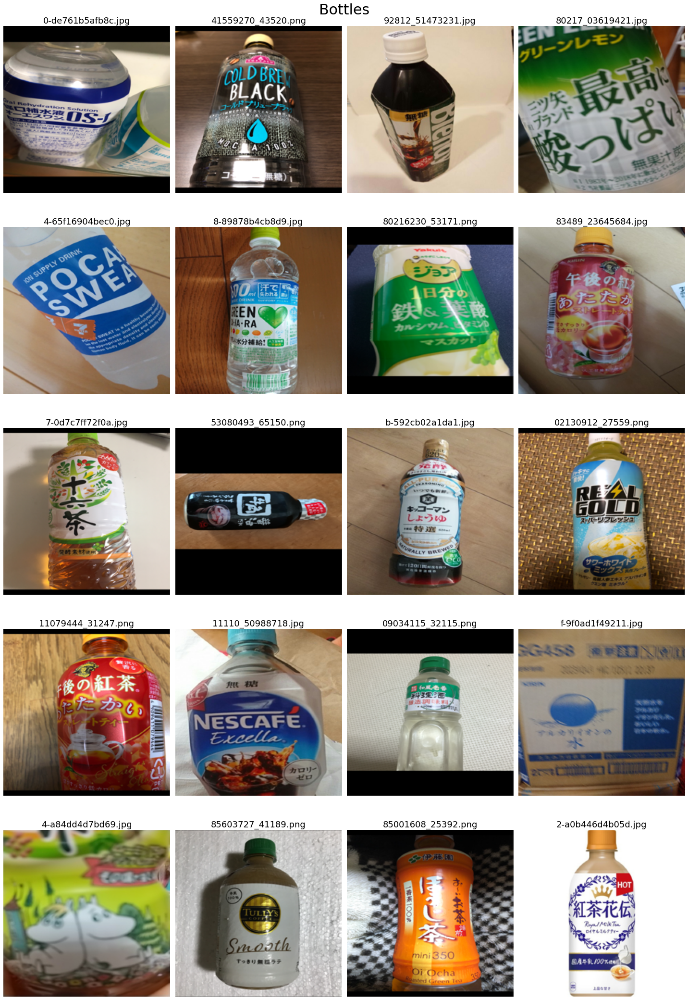

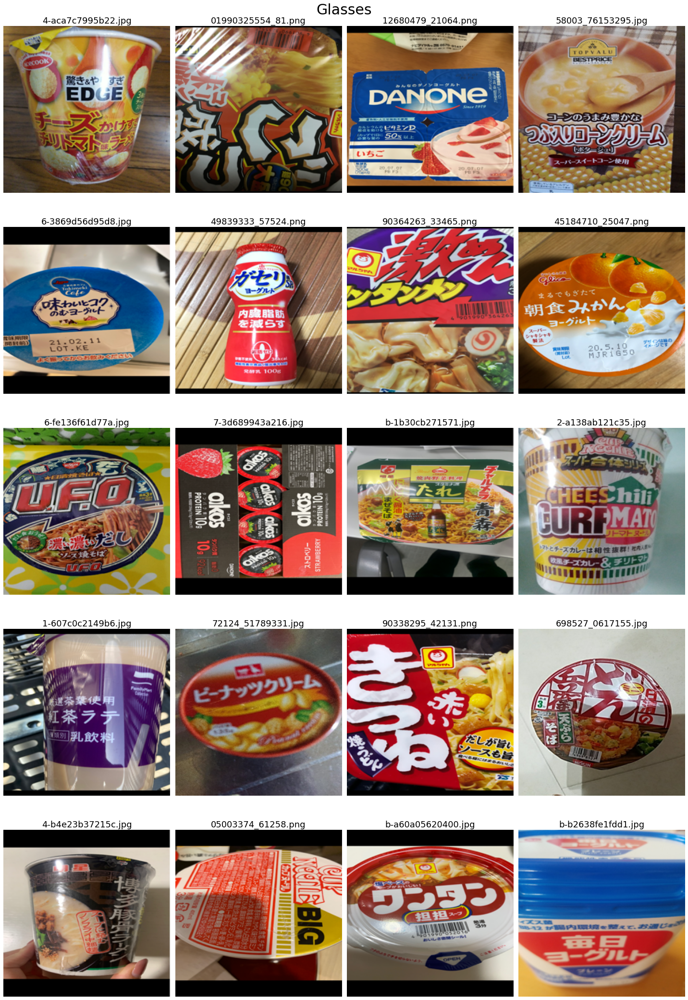

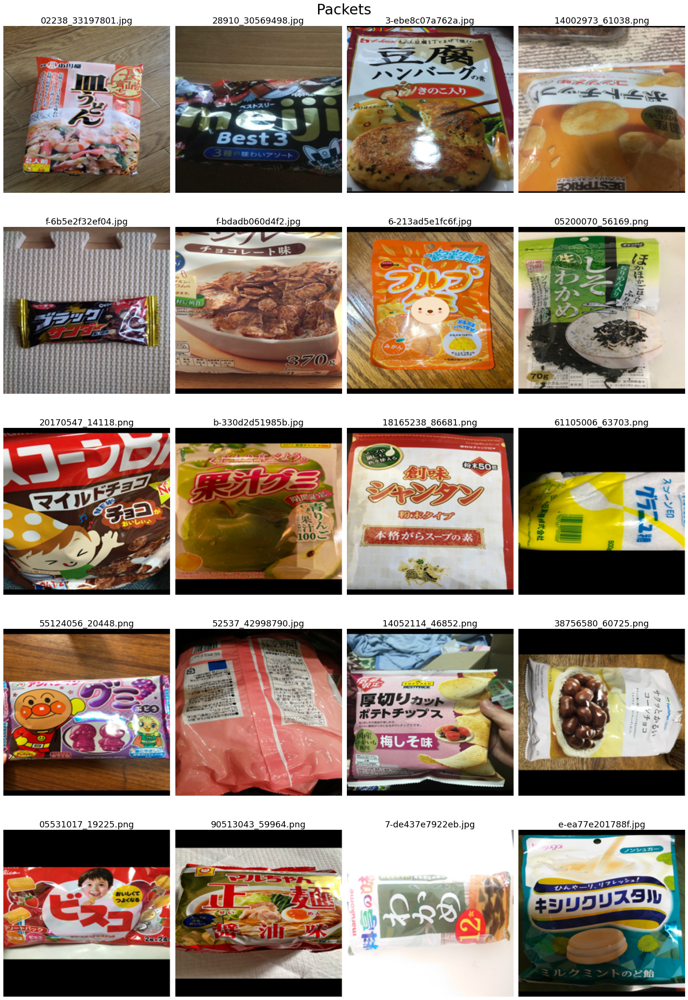

In [58]:
N = 20
nrows = 5
ncols = 4
figsize=(20, 30)

df_temp = df[df.container == "bottle"].sample(N).reset_index()
display_df(df_temp, "Bottles", nrows=nrows, ncols=ncols, num=N, figsize=figsize)

df_temp = df[df.container == "glass"].sample(N).reset_index()
display_df(df_temp, "Glasses", nrows=nrows, ncols=ncols, num=N, figsize=figsize)

df_temp = df[df.container == "packet"].sample(N).reset_index()
display_df(df_temp, "Packets", nrows=nrows, ncols=ncols, num=N, figsize=figsize)

In [71]:
incorrect_samples = {
    "59_4972070811014_40114566.jpg": "packet",
    "17_4548514153844_163687-e7363631-9696-42ce-b340-b1a39dc57553.jpg": "packet",
    "15_4582482530443_38911323.jpg": "unknown",
    "150_4514603367218_6869285.jpg": "unknown",
    "105_4901085045497_33478.png": "unknown",
    "12_4909411083120_29098.png": "unknown",
    "6_4902220073962_40067.png": "unknown",
    "69_4902705033481_1279001-cbc3985e-2d4f-41cc-9f26-6a553fbdfecd.jpg": "unknown",
    "126_4902102112147_2556651-f0699d59-587f-49c4-9e84-c88cf30197da.jpg": "unknown",
    "764_4901777314757_96381.png": "unknown",
    "147_4901777062702_1117905-cb26c4e9-a1fc-4441-aee9-5d818cfcdac3.jpg": "unknown",
    "73_4936790505103_46800-a742e2c2-3611-4a71-8650-21ea2bc8d352.jpg": "unknown",
    "10_4962823253017_86656.png": "packet",
    "755_49720693_81894144.jpg": "glass",
    "146_4987035576723_88515.png": "unknown",
    "593_4987035337218_523763-8664bc82-5be0-4cae-9f16-162667e7e5c8.jpg": "unknown",
    "6_4547894155561_29550.png": "unknown",
    "574_4902380188582_75612826.jpg": "unknown",
    "132_4902713126779_352334-e236a5aa-a5c4-43b3-b793-fb0e471af656.jpg": "unknown",
    "62_4904621050504_727336-0b86384d-c438-44a6-82aa-818bea1dff20.jpg": "packet",
    "1338_4970077101138_1335584-5021d2e0-b7ca-400d-b77f-7b1f217af0c8.jpg": "packet",
    "1400_4970077101138_2213765-8f16022a-ea86-47b9-8d58-0c4d3dd72b69.jpg": "packet",
    "1058_49878257_1339380-038b1e18-89c6-4575-8f67-19dfa038f801.jpg": "packet",
    "184_4548514139749_24170.png": "packet",
    "142_4548514139770_47181.png": "packet",
    "53_4901361053284_2305570-acce8800-e52a-4740-823b-90e1eab56d9c.jpg": "unknown",
    "10_4962739002754_323036-1410ea37-c7fe-4cbf-b12b-115b2c9c96aa.jpg": "unknown",
    "15_4970020016007_1233303-37fa19e9-46d1-4740-b6d8-62e545774eca.jpg": "unknown",
    "1552_4971666409710_68185.png": "unknown",
    "1047_4582409182601_2016782-f09e61c0-bc04-49ab-9294-54280e3f8ede.jpg": "unknown",
    "112_4582409182564_15581607.jpg": "unknown",
    "118_4571410226367_268377-e6cfced7-ad6c-45fe-954b-240ba147b8cb.jpg": "unknown",
    "1039_4549741658003_76153295.jpg": "unknown",
    "1736_4901001135806_2057461-1b3cf80f-eaba-4a6a-9288-f6e1a9f6c676.jpg": "packet",
    "1129_4901001159079_76698.png": "packet",
    "1022_4901001159079_57198.png": "packet",
    "643_4901001159079_30123-56296db7-8909-45ec-98e3-e4e463a8baea.jpg": "packet",
    "1483_4901001135820_62927.png": "packet",
    "1684_4901001135820_1909711-4322e4e2-d6fb-4f64-b7b4-b09003b6659d.jpg": "packet",
    "1757_4901001135820_271783-37ddf58e-0a59-4e4a-86e5-57f29d8e85e3.jpg": "packet",
    "101_4901001135714_110578-1a376e10-8a6a-4467-be3d-3aad38617768.jpg": "packet",
    "666_4901001131075_1315723-b54a87c3-dfb4-4e4a-b7fe-0ff5dafb941d.jpg": "packet",
    "749_4901001131075_45536.png": "packet",
    "516_4901001135769_1380176-36f61964-0158-47f3-a157-d2077076950f.jpg": "packet",
    "71_4901071239602_31862227.jpg": "bottle",
    "69_4901071246723_99785358.jpg": "bottle",
    "184_4901401063600_91833.png": "unknown",
    "13_4901990050616_7747973.jpg": "packet",
    "1768_4902105258538_620252-a3374345-cf18-47c0-b867-96479c698900.jpg": "unknown",
    "180_4902590131217_56501.png": "unknown",
    "102_4902713127738_84068.png": "unknown",
    "75_4902777007229_1217617-5e425912-ef7a-40dc-aef1-f002751c57ab.jpg": "unknown",
    "10_4902885004622_70217490.jpg": "unknown",
    "174_4978859000105_97866.png": "unknown",
    "555_4903050503834_84513.png" : "unknown",
    "146_4903050503834_60275360.jpg": "unknown",
    "1631_4903050503834_1882712-d127dd30-5270-428b-897d-3cc896b07722.jpg": "unknown",

}

In [72]:
incorrect_keys = incorrect_samples.keys()

In [73]:
df_incorrect = df[df.file_name.isin(list(incorrect_keys))]

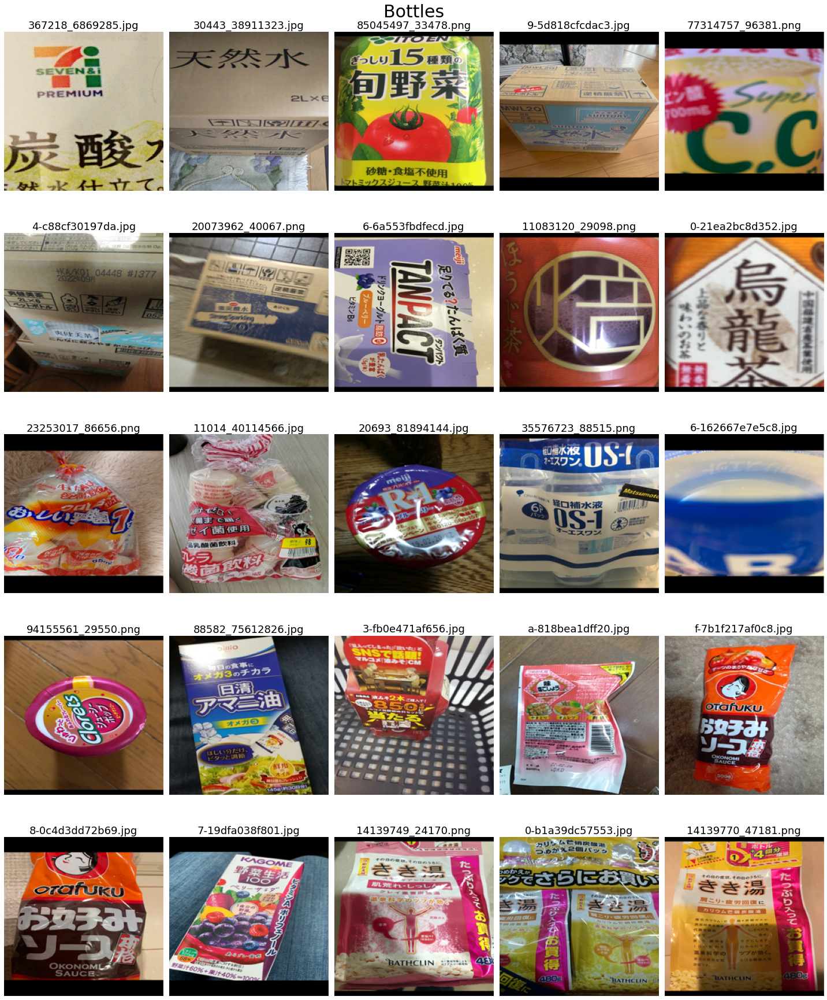

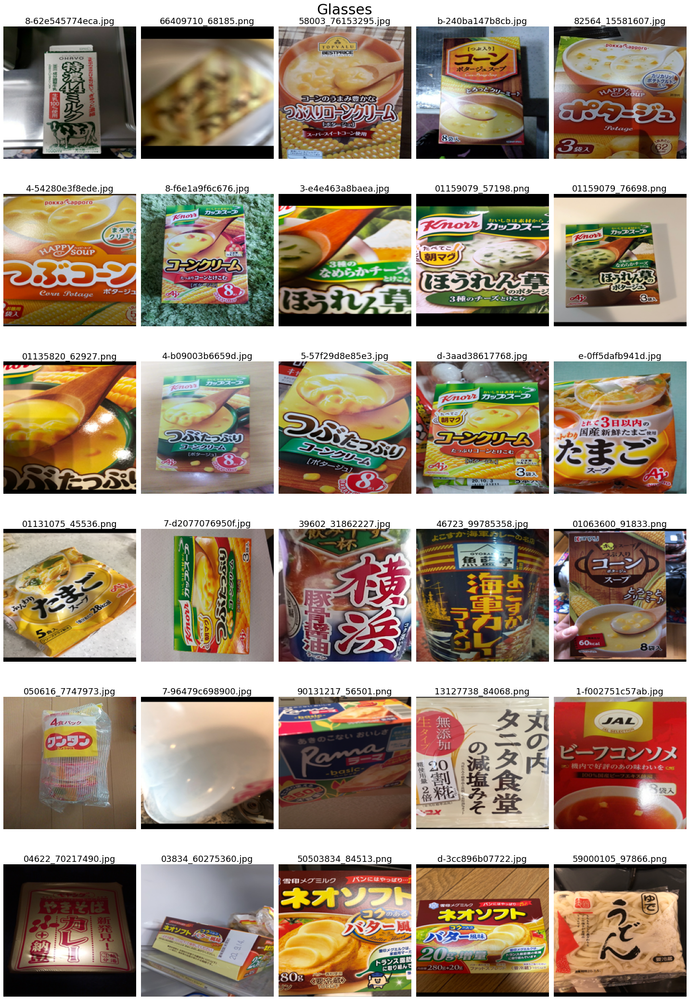

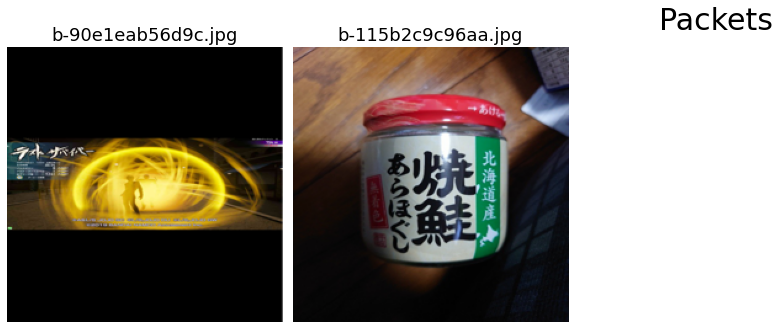

In [57]:
N = 30
nrows = 6
ncols = 5
figsize=(20, 30)

df_temp = df_incorrect[df_incorrect.container == "bottle"].reset_index()
display_df(df_temp, "Bottles", nrows=nrows, ncols=ncols, num=N, figsize=figsize)

df_temp = df_incorrect[df_incorrect.container == "glass"].reset_index()
display_df(df_temp, "Glasses", nrows=nrows, ncols=ncols, num=N, figsize=figsize)

df_temp = df_incorrect[df_incorrect.container == "packet"].reset_index()
display_df(df_temp, "Packets", nrows=nrows, ncols=ncols, num=N, figsize=figsize)